In [93]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from pandas_profiling import ProfileReport
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score,roc_curve


In [3]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [4]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [5]:
pf = ProfileReport(df)

In [8]:
pf.widgets

In [9]:
#as BMI cant be zero
#as dataset is skewed so go with mean.
df["BMI"] = df["BMI"].replace(0, df["BMI"].mean())

In [10]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [11]:
df["BloodPressure"] = df["BloodPressure"].replace(0, df["BloodPressure"].mean())

In [12]:
df["Insulin"] = df["Insulin"].replace(0, df["Insulin"].mean())
df["Glucose"] = df["Glucose"].replace(0, df["Glucose"].mean())
df["SkinThickness"] = df["SkinThickness"].replace(0, df["SkinThickness"].mean())

In [13]:
ProfileReport(df)

<AxesSubplot:>

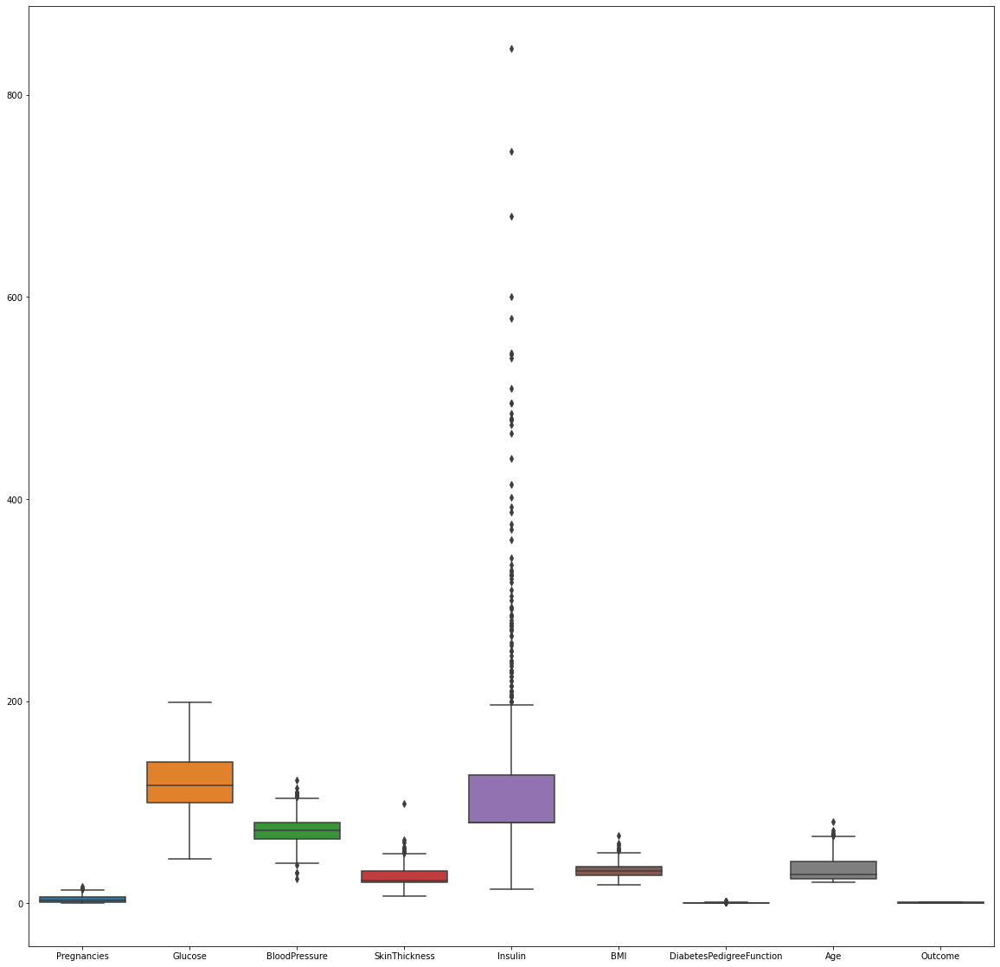

In [15]:
#finding and treating outliers
#form boxplot for finding outliers

fig, ax = plt.subplots(figsize=(20,20))
sns.boxplot(data = df, ax = ax)

In [22]:
#ways to handle outliers: 
#remove 5% of the data from insulin

q = df["Insulin"].quantile(.70)#loosing 30% of the dataset
df_new = df[df["Insulin"]<q]#selecting data which have 95% of the data

In [23]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
761,9,170.0,74.0,31.000000,79.799479,44.0,0.403,43,1
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

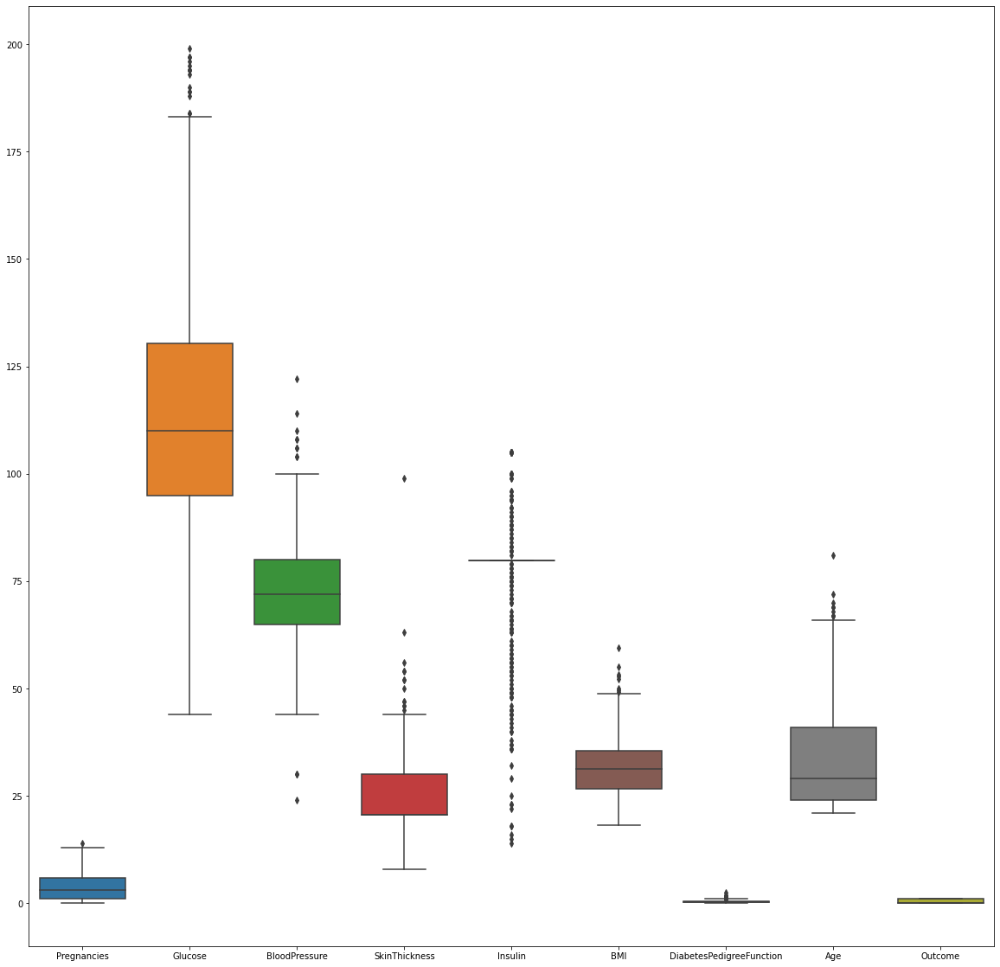

In [24]:
fig, ax = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = ax)

In [45]:
q = df["Pregnancies"].quantile(.98)
df_new = df[df["Pregnancies"]<q]

q = df_new["BMI"].quantile(.99)
df_new = df_new[df_new["BMI"]<q]

q = df_new["SkinThickness"].quantile(.99)
df_new = df_new[df_new["SkinThickness"]<q]

q = df_new["Insulin"].quantile(.95)
df_new = df_new[df_new["Insulin"]<q]

In [46]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

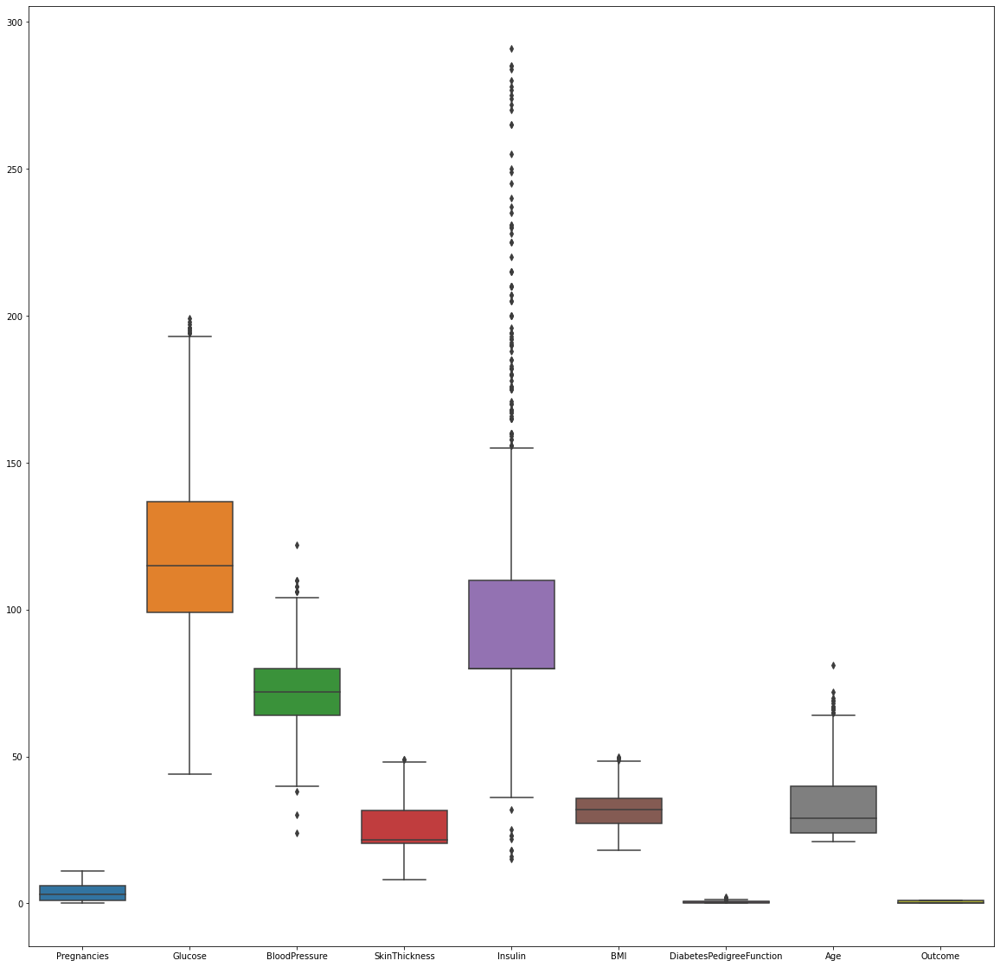

In [47]:
fig, ax = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = ax)

In [48]:
q = df_new["DiabetesPedigreeFunction"].quantile(.99)
df_new = df_new[df_new["DiabetesPedigreeFunction"]<q]

q = df_new["Age"].quantile(.99)
df_new = df_new[df_new["Age"]<q]

<AxesSubplot:>

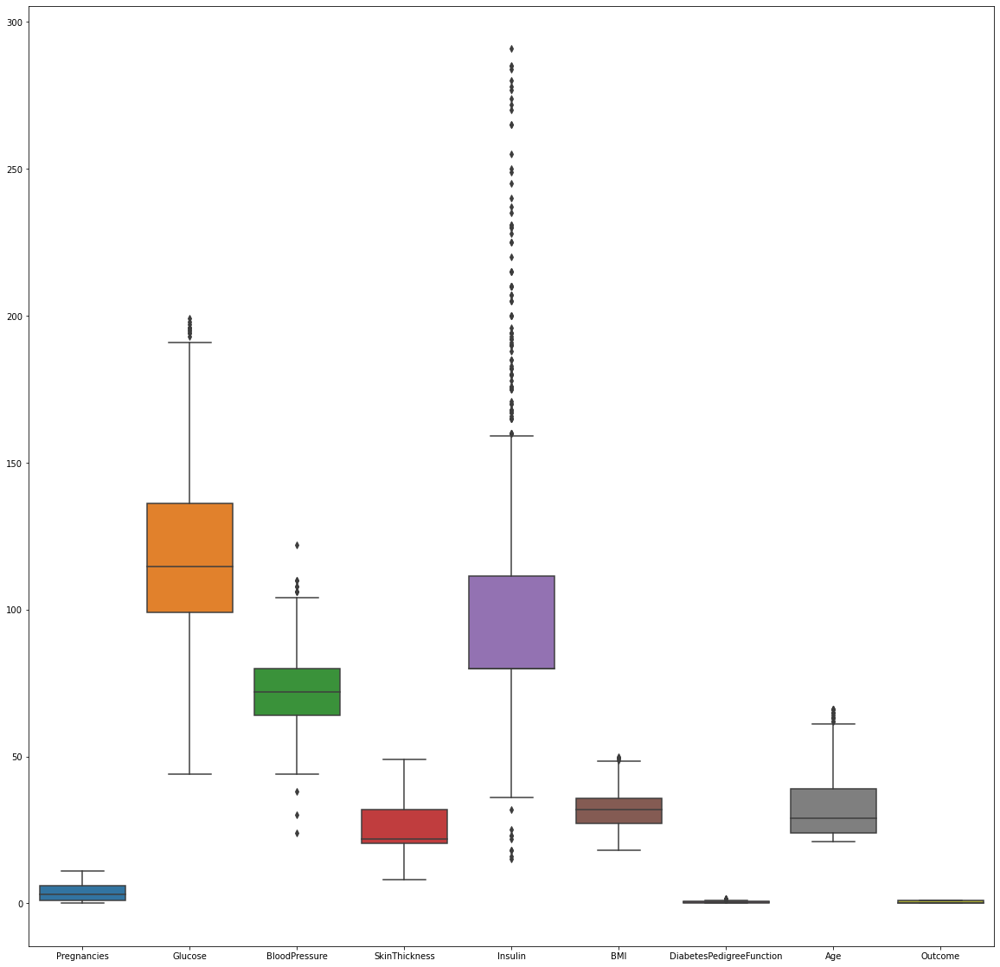

In [49]:
fig, ax = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new, ax = ax)

In [50]:
ProfileReport(df_new)

In [51]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [52]:
y = df_new["Outcome"]

In [53]:
x = df_new.drop(columns=["Outcome"])

In [54]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [55]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [57]:
#if dataset is fluctuating a lot use standared scaling
sclar = StandardScaler()
ProfileReport(pd.DataFrame(sclar.fit_transform(df_new)))

<AxesSubplot:>

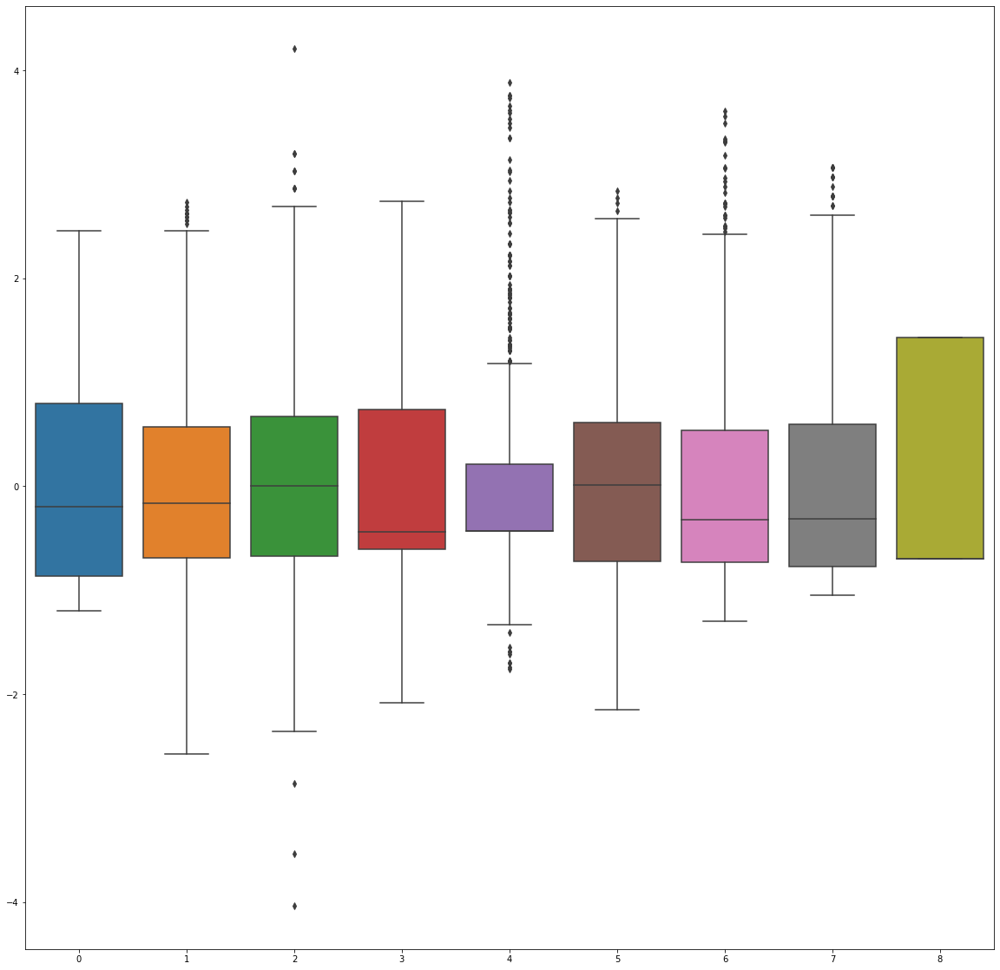

In [58]:
df_new_scalar = pd.DataFrame(sclar.fit_transform(df_new))
fig, ax = plt.subplots(figsize=(20,20))
sns.boxplot(data = df_new_scalar, ax = ax)

In [59]:
x_scaled = sclar.fit_transform(df_new)

In [60]:
x_scaled

array([[ 7.96753910e-01,  9.83984062e-01,  4.52611463e-04, ...,
         6.30484542e-01,  1.60141519e+00,  1.43170310e+00],
       [-8.64793539e-01, -1.16977621e+00, -5.04474494e-01, ...,
        -3.38078670e-01, -1.32706484e-01, -6.98468839e-01],
       [ 1.46137289e+00,  2.18051755e+00, -6.72783529e-01, ...,
         7.88402456e-01, -4.14369227e-02,  1.43170310e+00],
       ...,
       [ 4.64444420e-01,  6.09439465e-02,  4.52611463e-04, ...,
        -7.10063091e-01, -2.23976046e-01, -6.98468839e-01],
       [-8.64793539e-01,  2.31877301e-01, -1.00940160e+00, ...,
        -3.45097244e-01,  1.32760650e+00,  1.43170310e+00],
       [-8.64793539e-01, -8.96282840e-01, -1.67856424e-01, ...,
        -4.64413001e-01, -8.62862978e-01, -6.98468839e-01]])

In [61]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [85]:
def vif_score(x):
    scaler = StandardScaler()
    arr = scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=["FEATURE","VIF_SCORE"])



In [86]:
vif_score(x)

,FEATURE,VIF_SCORE
0,Pregnancies,1.449056
1,Glucose,1.304263
2,BloodPressure,1.262686
3,SkinThickness,1.470049
4,Insulin,1.271017
5,BMI,1.513160
6,DiabetesPedigreeFunction,1.042300
7,Age,1.662728


In [83]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [88]:
x_train,x_test,y_train,y_test = train_test_split(x_scaled,y,test_size = 20, random_state = 144)

In [89]:
x_train

array([[ 0.46444442, -1.58001626, -1.0094016 , ..., -0.62934949,
        -0.49778473, -0.69846884],
       [ 2.45830136,  0.64211735,  0.33707068, ..., -0.09593787,
         0.23237176, -0.69846884],
       [-0.86479354, -0.8279095 ,  0.16876165, ...,  0.79191174,
         0.32364132, -0.69846884],
       ...,
       [-0.86479354, -0.28092276,  1.17861586, ..., -1.06801036,
        -0.86286298, -0.69846884],
       [ 1.46137289,  0.02675728,  0.50537972, ..., -0.13454002,
         2.87918905, -0.69846884],
       [-0.86479354, -0.75953616, -0.33616546, ...,  2.27283086,
        -0.95413254, -0.69846884]])

In [90]:
x_test

array([[ 1.32134931e-01, -1.44176079e-01,  4.52611463e-04,
        -6.09921498e-01, -4.34192020e-01, -4.70915211e-01,
        -2.50346495e-01,  1.23633694e+00,  1.43170310e+00],
       [-1.19710303e+00,  6.76304024e-01, -8.41092564e-01,
        -1.02593023e+00,  2.22464049e+00, -1.53682948e+00,
        -8.43415997e-01, -1.04540210e+00, -6.98468839e-01],
       [ 2.45830136e+00,  8.13050708e-01,  1.85185200e+00,
         8.56218276e-01,  9.17692719e-01,  7.36075942e-01,
        -6.78479508e-01,  1.69268475e+00,  1.43170310e+00],
       [-8.64793539e-01,  6.09439465e-02,  5.05379717e-01,
         1.56202397e+00, -5.52623526e-01,  1.11228098e+00,
        -6.53914499e-01, -4.06515169e-01, -6.98468839e-01],
       [-8.64793539e-01,  8.47237378e-01,  8.41997787e-01,
         2.38546394e+00,  1.61200872e+00,  2.22522087e+00,
        -3.94227261e-01,  1.23633694e+00,  1.43170310e+00],
       [-5.32484049e-01, -1.03302952e+00,  1.51523393e+00,
         5.03315430e-01, -4.34192020e-01,  2.501444

In [96]:
logr = LogisticRegression(verbose=1)

In [97]:
logr.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=1)

In [102]:
logr.predict([x_test[0]])

array([1], dtype=int64)

In [99]:
logr.predict_proba([x_test[0]])

array([[0.01659094, 0.98340906]])

In [100]:
logr.predict_log_proba([x_test[0]])

array([[-4.09889852, -0.01673011]])

In [106]:
y_test.iloc[0]

1

In [107]:
logr_liblinear = LogisticRegression(verbose=1, solver="liblinear")

In [108]:
logr_liblinear.fit(x_train,y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [109]:
logr_liblinear

LogisticRegression(solver='liblinear', verbose=1)

In [110]:
logr

LogisticRegression(verbose=1)

In [112]:
y_pred_liblinear = logr_liblinear.predict(x_test)

In [113]:
y_pred_liblinear

array([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1],
      dtype=int64)

In [114]:
y_pred_default = logr.predict(x_test)

In [115]:
y_pred_default

array([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1],
      dtype=int64)

In [116]:
conf_matx_libliear = confusion_matrix(y_test,y_pred_liblinear)

In [117]:
conf_matx_libliear

array([[11,  0],
       [ 0,  9]], dtype=int64)

In [119]:
conf_matx_default = confusion_matrix(y_test,y_pred_default)

In [120]:
conf_matx_default

array([[11,  0],
       [ 0,  9]], dtype=int64)

In [123]:
def model_evaluation(y_test,y_preadicted):
    tn,fp,fn,tp= confusion_matrix(y_test,y_preadicted).ravel()
    accuracy = (tp-tn)/(tp+fp+fn+tn)
    precession = tp/(tp+fp)
    sensitivity = tp/(tp+fn)
    specificity = tn/(fp+tn)
    F1_score = 2*(sensitivity*precession)/(sensitivity+precession)
    result = {"Accuracy": accuracy,"Precession": precession, "Sensitivity":sensitivity,"Specificity":specificity,"F1 Score":F1_score}
    return result
model_evaluation(y_test,y_pred_liblinear)

{'Accuracy': -0.1,
 'Precession': 1.0,
 'Sensitivity': 1.0,
 'Specificity': 1.0,
 'F1 Score': 1.0}

In [124]:
model_evaluation(y_test,y_pred_default)

{'Accuracy': -0.1,
 'Precession': 1.0,
 'Sensitivity': 1.0,
 'Specificity': 1.0,
 'F1 Score': 1.0}

In [125]:
roc_auc_score(y_test,y_pred_default)

1.0

In [132]:
auc = roc_auc_score(y_test,y_pred_liblinear)

In [127]:
roc_curve(y_test,y_pred_liblinear)

(array([0., 0., 1.]), array([0., 1., 1.]), array([2, 1, 0], dtype=int64))

In [128]:
fpr,tpr,thresholds = roc_curve(y_test,y_pred_liblinear)

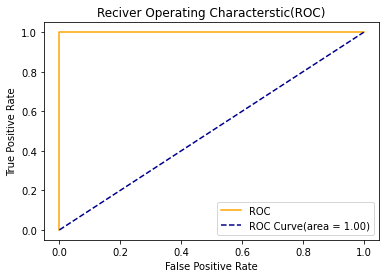

In [133]:
plt.plot(fpr,tpr,color="orange",label="ROC")
plt.plot([0,1],[0,1],color="darkblue",linestyle = "--",label= "ROC Curve(area = %0.2f)"% auc)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Reciver Operating Characterstic(ROC)")
plt.legend()
plt.show()